# PWS Cluster

In [1]:
from mylibs.datautils import read_navy_origin_data, parse_record_signal_file
from mylibs.utils import show_signal, show_signal_freqency
from mylibs.signal_preprocess import cut_head, PWS_signal_extract, get_pws_timeset
from mylibs.features_extracts import get_pws_shape_features
import matplotlib.pyplot as plt
import numpy as np
import os, shutil
import pandas as pd


NAVY_DATAPATH = '/root/hdd/datasets/navy_glucose'

In [2]:
pinfos_frame, pmeta_frame = read_navy_origin_data(NAVY_DATAPATH)

## Example of PWS

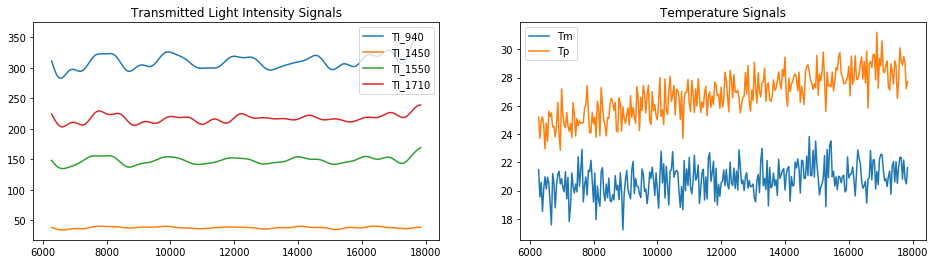

In [3]:
# load an example signal
example_idx = 34   # 34, 37 is best
bgc_example, r_time_example, signal_example = parse_record_signal_file(
    pmeta_frame.loc[example_idx, 'signal_url(s)'])
signal_cut_example, incident_intensity = cut_head(signal_example)

# extract pws
pws_example, _ = PWS_signal_extract(signal_cut_example, AC=[1, 1.5])

plt.figure(figsize=(16, 4))
show_signal(pws_example)
plt.show()

## Extract PWS shape features

In [4]:
shape_feature_example, cycle_example = get_pws_shape_features(pws_example)
print(shape_feature_example)

[0.16578363 0.30540433 0.86126448 0.82015513 0.34634553]


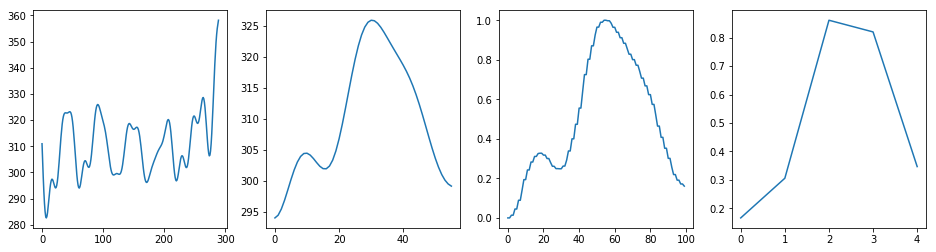

In [5]:
plt.figure(figsize=(16, 4))
plt.subplot(141)
plt.plot(pws_example[1])
plt.subplot(142)
plt.plot(cycle_example['Tt_cycle'])
plt.subplot(143)
plt.plot(cycle_example['Tt_cycle_nor'])
plt.subplot(144)
plt.plot(shape_feature_example)
plt.show()

## PWS shape cluster

In [6]:
# get shape features from all pws
shape_feature_list = []
signal_cycle_list = []
signal_file_list = []
for idx in range(len(pmeta_frame)):
    
    signal_file_list.append(pmeta_frame.loc[idx, 'signal_url(s)'])
    _, _, signal = parse_record_signal_file(pmeta_frame.loc[idx, 'signal_url(s)'])
    signal_cut, _ = cut_head(signal)
    pws, _ = PWS_signal_extract(signal_cut, AC=[1, 1.5])
    
    shape_feature, cycle = get_pws_shape_features(pws)
    shape_feature_list.append(shape_feature)
    signal_cycle_list.append(cycle['Tt_cycle'])
shape_feature_list = np.array(shape_feature_list)
signal_cycle_list = np.array(signal_cycle_list)

print(shape_feature_list.shape)
print(signal_cycle_list.shape)

(4012, 5)
(4012,)


In [25]:
from sklearn.cluster import KMeans
from skfuzzy.cluster import cmeans

# kmeans = KMeans(n_clusters=4, random_state=0).fit(shape_feature_list)
kmeans = cmeans
pws_types = kmeans.labels_
pws_center = kmeans.cluster_centers_
print(pws_center)
print(pws_types)

# saving cluster label for k-NN
features_for_df = {'f_' + str(i): shape_feature_list[:, i] for i in [0, 1, 2, 3, 4]}
features_for_df['type'] = pws_types
file_pws_types_df = pd.DataFrame(features_for_df)
file_pws_types_df.to_csv(os.path.join('./features_pws_types.csv'))

[[0.18071263 0.5863071  0.7645272  0.8821326  0.47061265]
 [0.17787133 0.39547134 0.26431331 0.42937979 0.61383145]
 [0.20280362 0.4199392  0.87609892 0.56165992 0.34759766]
 [0.29909359 0.81756383 0.78464765 0.58802383 0.32646916]]
[3 2 3 ... 2 2 3]


### Draw cluster map by t-SNE

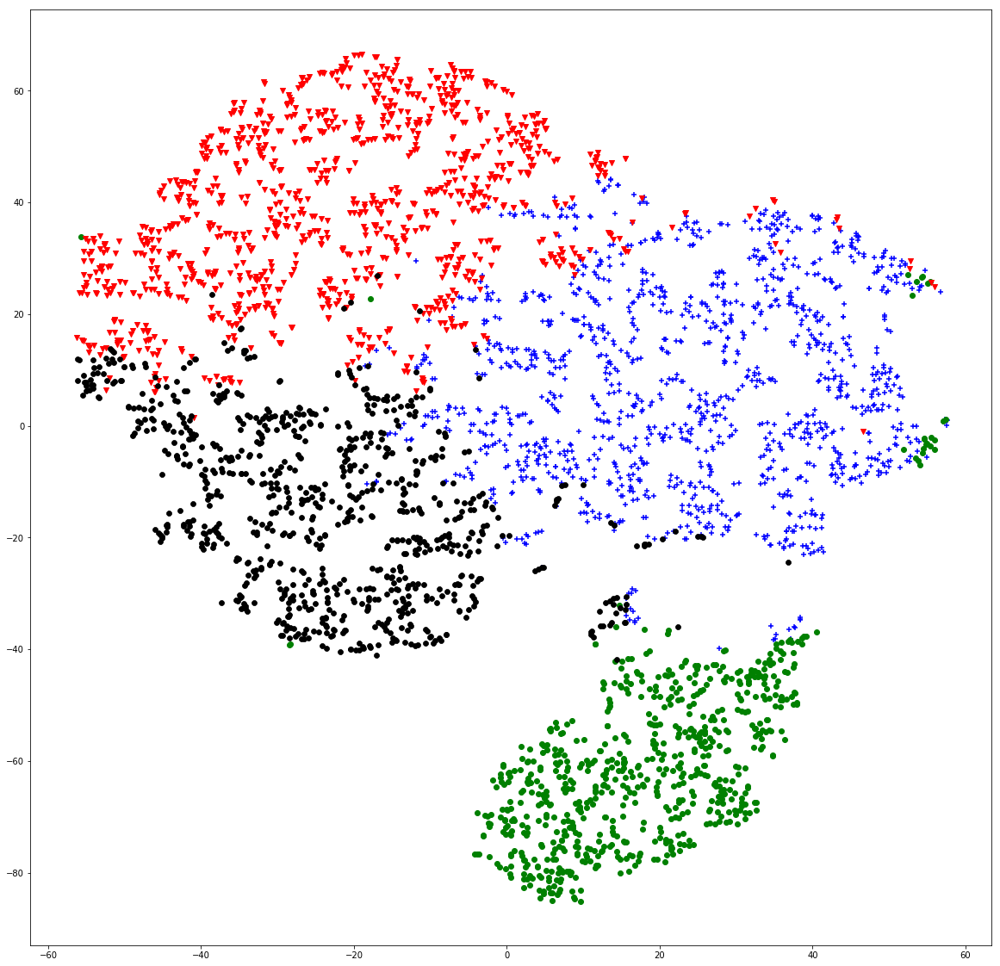

In [10]:
# show features by tsne
from sklearn.manifold import TSNE
X_tsne = TSNE(learning_rate=100).fit_transform(shape_feature_list)
plt.figure(figsize=(20, 20))
plt.subplot(111)
plt.scatter(X_tsne[pws_types==0, 0], X_tsne[pws_types==0, 1], c='b', marker='+')
plt.scatter(X_tsne[pws_types==1, 0], X_tsne[pws_types==1, 1], c='g', marker='o')
plt.scatter(X_tsne[pws_types==2, 0], X_tsne[pws_types==2, 1], c='r', marker='v')
plt.scatter(X_tsne[pws_types==3, 0], X_tsne[pws_types==3, 1], c='k', marker='8')
plt.show()

In [11]:
# saving cluster result and t-sne result
saving_dir = os.path.join("./tmp", "pws_cluster")
if os.path.exists(saving_dir):
    shutil.rmtree(saving_dir)
os.mkdir(saving_dir)
np.savetxt(os.path.join(saving_dir, 'x_tsne.csv'), X_tsne, delimiter=',')
np.savetxt(os.path.join(saving_dir, 'shape_features.csv'), shape_feature_list, delimiter=',')

/root/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


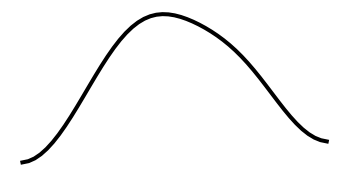

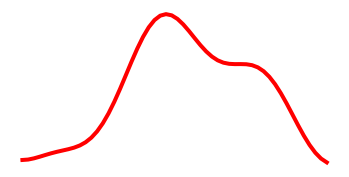

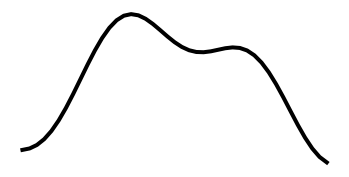

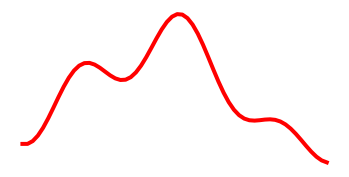

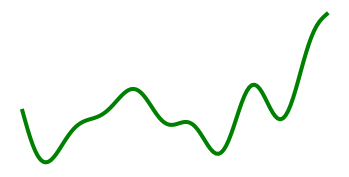

...

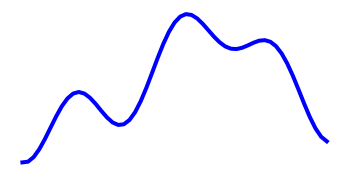

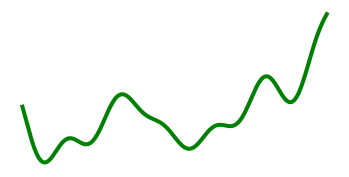

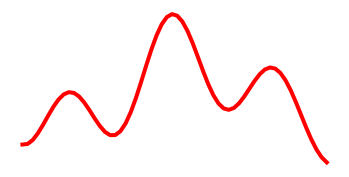

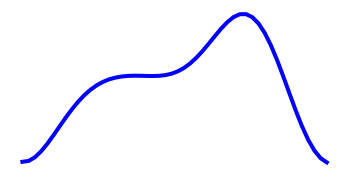

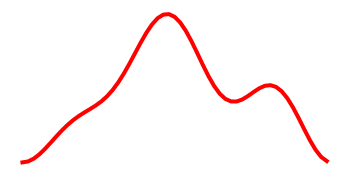

In [12]:
# 保存每个周期信号和周期信号图
colors = {0: 'b', 1: 'g', 2: 'r', 3: 'k'}
img_path_list = []
for i in range(len(signal_cycle_list)):
    
    type_dir = os.path.join(saving_dir, str(pws_types[i]))
    if not os.path.exists(type_dir):
        os.mkdir(type_dir)
    
    # 保存一个周期信号
    np.savetxt(os.path.join(type_dir, "%s.csv"%(i)),  signal_cycle_list[i].transpose(), delimiter=',')
    
    # 保存一个周期信号的绘图
    img_save_path = os.path.join(type_dir, "%s.png"%(i))
    plt.figure(figsize=(6, 3))
    plt.plot(signal_cycle_list[i], c=colors[pws_types[i]], linewidth = '4')
    plt.axis("off")
    plt.xticks([])
    plt.yticks([])
    plt.savefig(img_save_path)
    img_path_list.append(img_save_path)

In [13]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.cbook import get_sample_data


def imscatter(x, y, image, ax=None, zoom=1):
    if ax is None:
        ax = plt.gca()
    try:
        image = plt.imread(image)
    except TypeError:
        # Likely already an array...
        pass
    im = OffsetImage(image, zoom=zoom)
    x, y = np.atleast_1d(x, y)
    artists = []
    for x0, y0 in zip(x, y):
        ab = AnnotationBbox(im, (x0, y0), xycoords='data', frameon=False)
        artists.append(ax.add_artist(ab))
    ax.update_datalim(np.column_stack([x, y]))
    ax.autoscale()
    return artists

In [14]:
plt.figure(figsize=(20, 20))
plt.subplot(111)
for i in range(len(signal_cycle_list)):
    imscatter(X_tsne[i, 0], X_tsne[i, 1], img_path_list[i], zoom=0.2)
plt.show()

### k-NN for PWS Classification

In [35]:
from mylibs.models import KnnPwsClassification

In [36]:
knn_pws_cls = KnnPwsClassification(n_neighbors=10)
knn_pws_cls.fit(features_file='./features_pws_types.csv')
type_predict = knn_pws_cls.predict([[0.0543290783838478,0.3803394046605291,0.926099522487631,0.6731195489158396,0.2771035161263539]])
print(type_predict)

X shape:  (4012, 5)
y shape:  (4012,)
[2]
